# Librerias

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

import os
import geopandas as gpd
import plotly.express as px
import folium
import json

In [2]:
os.chdir(path="../datos/unificado/")

Cargar datos y ajustar el formato 'BARRIO'.

In [4]:
df = pd.read_csv("homicidios.csv")

# Extraer la parte del barrio sin la "E-XX"
df['NOMBRE_BARRIO'] = df['BARRIO'].str.extract(r'(.*) E-\d+')

# Extraer el número después de "E-"
df['LOCALIDAD'] = df['BARRIO'].str.extract(r'E-(\d+)')

In [5]:
df.head()

,FECHA,DIA,HORA,BARRIO,MES,ZONA,CLASE_DE_SITIO,ARMA_EMPLEADA,MOVIL_VICTIMA,MOVIL_AGRESOR,EDAD,ESTADO_CIVIL,PAIS_NACIMIENTO,CLASE_EMPLEADO,PROFESION,ESCOLARIDAD,GENERO,DESCRIPCION_CONDUCTA,NOMBRE_BARRIO,LOCALIDAD
0,2010-01-01,Viernes,17:00:00,ANTONIA SANTOS E-7,ene.,URBANA,VIAS PUBLICAS,ARMA DE FUEGO,A PIE,A PIE,40.0,CASADO,COLOMBIA,EMPLEADO PARTICULAR,-,SECUNDARIA,MASCULINO,ARTÍCULO 103. HOMICIDIO,ANTONIA SANTOS,7
1,2010-01-01,Viernes,11:00:00,EL AMPARO E-8,ene.,URBANA,VIAS PUBLICAS,ARMA BLANCA / CORTOPUNZANTE,A PIE,A PIE,37.0,SOLTERO,COLOMBIA,COMERCIANTE,-,SECUNDARIA,MASCULINO,ARTÍCULO 103. HOMICIDIO,EL AMPARO,8
2,2010-01-01,Viernes,05:30:00,GUACAMAYAS I-II E-4,ene.,URBANA,VIAS PUBLICAS,ARMA DE FUEGO,A PIE,A PIE,18.0,SOLTERO,COLOMBIA,EMPLEADO PARTICULAR,-,SECUNDARIA,MASCULINO,ARTÍCULO 103. HOMICIDIO,GUACAMAYAS I-II,4
3,2010-01-01,Viernes,05:30:00,GUACAMAYAS I-II E-4,ene.,URBANA,VIAS PUBLICAS,ARMA DE FUEGO,A PIE,A PIE,25.0,NO REPORTA,COLOMBIA,INDEPENDIENTE,-,PRIMARIA,MASCULINO,ARTÍCULO 103. HOMICIDIO,GUACAMAYAS I-II,4
4,2010-01-01,Viernes,19:40:00,LA FLORIDA SUR E-19,ene.,URBANA,VIAS PUBLICAS,ARMA BLANCA / CORTOPUNZANTE,A PIE,A PIE,47.0,CASADO,COLOMBIA,EMPLEADO PARTICULAR,-,SECUNDARIA,MASCULINO,ARTÍCULO 103. HOMICIDIO,LA FLORIDA SUR,19


In [8]:
df_unique_barrios = df[['NOMBRE_BARRIO', 'LOCALIDAD']].drop_duplicates()
dic_unique_barrios = {"NOMBRE_BARRIO":df_unique_barrios["NOMBRE_BARRIO"].values.tolist(),"LOCALIDAD":df_unique_barrios["LOCALIDAD"].values.tolist()}

In [9]:
dic_unique_barrios["NOMBRE_BARRIO"]

['ANTONIA SANTOS',
 'EL AMPARO',
 'GUACAMAYAS I-II',
 'LA FLORIDA SUR',
 'SANTA CECILIA I',
 'LA VICTORIA',
 'POTOSI',
 'DIANA TURBAY',
 'VILLA GLORIA',
 'LA FAVORITA',
 'LAS BRISAS',
 'QUIRIGUA I',
 'SANTA ROSA SUR',
 'VILLA NYDIA',
 'EL PARAISO',
 'EL PORVENIR',
 'EL RECREO',
 'VOTO NACIONAL',
 'DANUBIO AZUL',
 'CARLOS ALBAN HOLGUIN',
 'LAS CRUCES',
 'SAN BERNARDO',
 'LOS PINOS',
 'CLASS',
 'SIMON BOLIVAR',
 'LA LIBERTAD I',
 'UNICENTRO',
 'LA PRIMAVERA NORTE',
 'CASAVIANCA',
 'LAS ORQUIDEAS',
 'SAN CARLOS',
 'LOS LACHES',
 'EL CORTIJO',
 'LA AURORA I SECTOR',
 'TIBABUYES I SECTOR',
 'JERUSALEN',
 'LA ALQUERIA',
 'AMERICAS OCCIDENTAL I ETAPA',
 'GUSTAVO RESTREPO',
 'CANDELARIA LA NUEVA I SECTOR',
 'NUEVA ARGENTINA',
 'LAS COLUMNAS',
 'TEUSAQUILLO',
 'SAN FRANCISCO',
 'ENGATIVA',
 'VILLA GLADIS',
 'LAGUNETA',
 'CHAPINERO CENTRAL',
 'SANTA LIBRADA',
 'BETANIA',
 'ARBORIZADORA ALTA',
 'HOLANDA',
 'CIUDAD KENNEDY CENTRO CIVICO D.L.F.',
 'BACHUE',
 'LUCERO ALTO',
 'CERROS NORTE',
 'LOS AL

Obtener poligonos de los barrios con reportes.

In [11]:
# JSON file
#f = open ('barrios_prueba.json', "r")'SECTOR.GEOJSON.0823.geojson'
f = open ('SECTOR.GEOJSON.0823.geojson', "r")
# Reading from file
data = json.loads(f.read())

j = 0
found_names = []
names_except_found = []
# Iterating through the json list
for i in data['features']:
    #candidate = i["barriocomu"].upper()
    candidate = i['properties']['SCANOMBRE'].upper()
    if candidate in dic_unique_barrios["NOMBRE_BARRIO"]:
        found_names.append(candidate)
        #print(candidate)
        j=j+1
    else:
        names_except_found.append(candidate)

print(j) 
# Closing file
f.close()

FileNotFoundError: [Errno 2] No such file or directory: 'SECTOR.GEOJSON.0823.geojson'

In [12]:
found_names

NameError: name 'found_names' is not defined

In [9]:
not_found_names = [i for i in dic_unique_barrios["NOMBRE_BARRIO"] if i not in found_names]

In [19]:
not_found_names

['EL AMPARO',
 'GUACAMAYAS I-II',
 'LA FLORIDA SUR',
 'SANTA CECILIA I',
 'SANTA ROSA SUR',
 'VILLA NYDIA',
 'EL PORVENIR',
 'EL RECREO',
 'DANUBIO AZUL',
 'CARLOS ALBAN HOLGUIN',
 'LOS PINOS',
 'LA LIBERTAD I',
 'UNICENTRO',
 'LA PRIMAVERA NORTE',
 'CASAVIANCA',
 'LA AURORA I SECTOR',
 'TIBABUYES I SECTOR',
 'LA ALQUERIA',
 'AMERICAS OCCIDENTAL I ETAPA',
 'CANDELARIA LA NUEVA I SECTOR',
 'NUEVA ARGENTINA',
 'LAS COLUMNAS',
 'ENGATIVA',
 'VILLA GLADIS',
 'LAGUNETA',
 'HOLANDA',
 'CIUDAD KENNEDY CENTRO CIVICO D.L.F.',
 'BACHUE',
 'CERROS NORTE',
 'BOSA CARBONEL II',
 'RINCONCITO',
 'MIRAVALLE',
 'LA CAÑIZA SECTOR I',
 'SANTA CECILIA NORTE PARTE ALTA',
 'LAS PALMERAS',
 'URB. ACAPULCO',
 'ALHAMBRA SECTOR NORTE',
 'GUAVIO',
 'LOS MOLINOS II SECTOR',
 'EL RECREO DE LOS FRAYLES',
 'BOSQUE DE LA COLINA',
 'ALQUERIAS DE LA FRAGUA',
 'URB. NUEVA ZELANDIA',
 'EL PORVENIR',
 'ABRAHAM LINCON',
 'BOSA CENTRO',
 'URB. TOBERIN',
 'ALCAPARROS I-II',
 'EL ANHELO',
 'POLICARPA SALAVARRIETA',
 'SAN JORG

In [10]:
print(f'Se tienen reportes de: {len(dic_unique_barrios["NOMBRE_BARRIO"])} barrios')
print(f'Se encontraron los poligonos de {len(found_names)} poligonos')
print(f'No se han encontrado los poligonos de {len(not_found_names)} barrios.')

Se tienen reportes de: 1828 barrios
Se encontraron los poligonos de 607 poligonos
No se han encontrado los poligonos de 1124 barrios.


In [11]:
kennedy = df_unique_barrios[(df_unique_barrios["LOCALIDAD"] == '8') & df_unique_barrios["NOMBRE_BARRIO"].isin(not_found_names)]["NOMBRE_BARRIO"].tolist()
kennedy.sort()
len(kennedy)

146

In [44]:
kennedy

['ABRAHAM LINCON',
 'ACIP',
 'ALMENDROS TINTALITO BOSA',
 'ALOHA NORTE',
 'ALQUERIA DE LAFRAGUA SECTOR PARAISO',
 'ALQUERIAS DE LA FRAGUA',
 'ALQUERIAS DE LA FRAGUA VILLANUEVA',
 'ALSACIA',
 'ALTAMAR',
 'AMAPARO CAÑIZARES',
 'AMERICAS OCCIDENTAL I ETAPA',
 'AMERICAS OCCIDENTAL II ETAPA',
 'AMERICAS RESERVADO',
 'ANDALUCIA',
 'ANDALUCIA II SECTOR',
 'ARGELIA',
 'BANDERAS',
 'BOMBAY',
 'BOSQUES DE CASTILLA',
 'BRASILIA I SECTOR',
 'BUENA VISTA',
 'CALARCA',
 'CALIFORNIA',
 'CAMPO ALEGRE',
 'CARACOL',
 'CARIMAGUA I SECTOR',
 'CARVAJAL',
 'CASABLANCA I',
 'CASABLANCA III',
 'CASTILLA LA NUEVA',
 'CASTILLA REAL',
 'CERVANTES',
 'CHUCUA DE LA VACA',
 'CHUCUA EL BURRO',
 'CIUDAD GALAN',
 'CIUDAD GRANADA',
 'CIUDAD KENNEDY CENTRO CIVICO D.L.F.',
 'CIUDAD KENNEDY OCC',
 'CIUDAD KENNEDY SPMZ 1',
 'CONDOMINIO RESIDENCIAL TIMIZA',
 'EL ALMENAR',
 'EL AMPARO',
 'EL CONDADO DE LA PAZ',
 'EL FERROL',
 'EL JAZMIN RURAL',
 'EL LLANITO',
 'EL OLIVO',
 'EL PORVENIR',
 'EL RINCON DE CASTILLA',
 'EL RINCON

In [13]:
# JSON file
#f = open ('barrios_prueba.json', "r")'SECTOR.GEOJSON.0823.geojson'
f = open ('SECTOR.GEOJSON.0823.geojson', "r")
# Reading from file
data = json.loads(f.read())

desired_polygons = [feature for feature in data['features'] if feature['properties']['SCANOMBRE'].upper() in found_names]
f.close()

# Crear un mapa
m = folium.Map(location=[4.60971, -74.08175], zoom_start=12)  # Centra el mapa en Bogotá

# Agregar las características filtradas al mapa
folium.GeoJson(
    {   
        "type": "FeatureCollection",
        "features": desired_polygons
    },
    name='Polígonos a Visualizar'
).add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa_filtrado.html')

FileNotFoundError: [Errno 2] No such file or directory: 'SECTOR.GEOJSON.0823.geojson'

In [22]:
# JSON file
#f = open ('barrios_prueba.json', "r")'SECTOR.GEOJSON.0823.geojson'
f = open ('SECTOR.GEOJSON.0823.geojson', "r")
# Reading from file
data = json.loads(f.read())

polygons = [feature for feature in data['features'] if feature['properties']['SCANOMBRE'].upper() in found_names]
desired_polygons = [feature for feature in data['features'] if feature['properties']['SCANOMBRE'].upper() not in found_names]
f.close()

# Crear un mapa
m = folium.Map(location=[4.60971, -74.08175], zoom_start=12)  # Centra el mapa en Bogotá

# Agregar las características filtradas al mapa con ventanas emergentes
for feature in polygons:
    nombre_poligono = feature['properties']['SCANOMBRE']
    popup = folium.Popup(nombre_poligono, parse_html=True)
    folium.GeoJson(
        feature,
        name=nombre_poligono,
        style_function=lambda x: {'color': 'blue'}  # Ajusta el estilo del polígono
    ).add_child(popup).add_to(m)
    
for feature in desired_polygons:
    nombre_poligono = feature['properties']['SCANOMBRE']
    popup = folium.Popup(nombre_poligono, parse_html=True)
    folium.GeoJson(
        feature,
        name=nombre_poligono,
        style_function=lambda x: {'color': 'red'}  # Ajusta el estilo del polígono
    ).add_child(popup).add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa_filtrado.html')

In [14]:
os.getcwd()

'c:\\Users\\sdsal\\OneDrive - Universidad de los Andes\\2023-2\\Tesis\\datos\\unificado'

In [17]:
os.chdir(path="../datos_aux/")

In [18]:
f = open ('barrios_prueba.geojson', "r")
data = json.loads(f.read())
for feature in data['features']:
    print(feature)

{'type': 'Feature', 'geometry': {'coordinates': [[[-74.12214401799997, 4.643058445000008], [-74.12345051699998, 4.641475752000019], [-74.12351315000001, 4.641611135000005], [-74.12359344700002, 4.641835500000013], [-74.123691759, 4.642104567999979], [-74.12374517, 4.642319751999991], [-74.12379013600003, 4.642535216999988], [-74.123915383, 4.643333305999988], [-74.124013333, 4.643837682000025], [-74.12382378500001, 4.644068885000024], [-74.12362705700002, 4.644274736999989], [-74.12362227199998, 4.64427071099999], [-74.12214401799997, 4.643058445000008]]], 'type': 'Polygon'}, 'properties': {'objectid': 624, 'cod_loc': 9, 'localidad': 'Fontibón', 'estado': 'SIN LEGALIZAR', 'barriocomu': 'Urb. Montevideo Mz 13B', 'cod_polbar': 90163, 'shape_area': 2.670968925448e-06, 'shape_len': 0.006991416652801, 'geo_point_2d': {'lon': -74.1232389247289, 'lat': 4.642972091298056}}}
{'type': 'Feature', 'geometry': {'coordinates': [[[-74.11652821799998, 4.680412955000008], [-74.11668089800003, 4.6803104

In [19]:
# JSON file
f = open ('barrios_prueba.geojson', "r")#'SECTOR.GEOJSON.0823.geojson'
#f = open ('barriolegalizado.geojson', "r")
# Reading from file
data = json.loads(f.read())

polygons = [feature for feature in data['features']]
f.close()

# Crear un mapa
m = folium.Map(location=[4.60971, -74.08175], zoom_start=12)  # Centra el mapa en Bogotá

# Agregar las características filtradas al mapa con ventanas emergentes
for feature in polygons:
    nombre_poligono = feature['properties']['barriocomu']
    popup = folium.Popup(nombre_poligono, parse_html=True)
    folium.GeoJson(
        feature,
        name=nombre_poligono,
        style_function=lambda x: {'color': 'blue'}  # Ajusta el estilo del polígono
    ).add_child(popup).add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa.html')

In [20]:
# Carga los datos geoespaciales de las localidades de Bogotá
#localidades = gpd.read_file("datos_aux/poligonos-localidades.geojson")
barrios = gpd.read_file("barrios_prueba.geojson")
otros_barrios = gpd.read_file("SECTOR.GEOJSON.0823.geojson")
estaciones = gpd.read_file("estacion-de-policia.geojson")
cais = gpd.read_file("cai.geojson")

In [21]:
fig = px.scatter_mapbox(cais,
                        lat=cais.geometry.y,
                        lon=cais.geometry.x,
                        zoom=1)
fig.show()

In [22]:
fig.show()

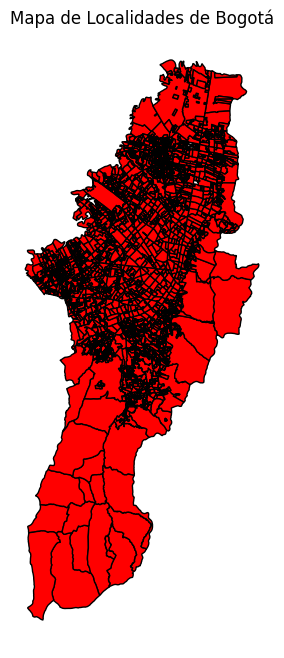

In [12]:
# Crea un nuevo gráfico de matplotlib
fig, ax = plt.subplots(1, 1, figsize=(12, 8))

# Dibuja los barrios en el mapa
estaciones.plot(ax=ax, color='lightblue', edgecolor='black')
# Dibuja las estaciones en el mapa
barrios.plot(ax=ax, color='red', edgecolor='black')

# Configura el aspecto del mapa
ax.set_title("Mapa de Localidades de Bogotá")
ax.axis('off')  # Desactiva los ejes

# Muestra el mapa
plt.show()

In [21]:
# Crear un mapa
m = folium.Map(location=[4.60971, -74.08175], zoom_start=12)  # Centra el mapa en Bogotá

In [22]:
# Agregar la primera capa GeoJSON al mapa con un estilo personalizado (color rojo)
folium.GeoJson('SECTOR.GEOJSON.0823.geojson',
            name='Otros Barrios',
            zoom_on_click=True).add_to(m)
# Agregar la primera capa GeoJSON al mapa con un estilo personalizado (color rojo)
folium.GeoJson('barrios_prueba.geojson',
            name='Barrios',
            style_function=lambda x:{'color': 'red'},
            zoom_on_click=True).add_to(m)
folium.LayerControl().add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa_mmmm.html')

In [27]:
for feature in folium.GeoJson('SECTOR.GEOJSON.0823.geojson').data['features']:
    nombre_barrio=feature['properties']['SCANOMBRE']
    popup = folium.Popup(nombre_barrio, parse_html=True)
    popup.add_to(folium.GeoJson('SECTOR.GEOJSON.0823.geojson'))

In [ ]:
# Guardar el mapa en un archivo HTML
m.save('mapa.html')

In [14]:
# Agregar la primera capa GeoJSON al mapa con un estilo personalizado (color rojo)
folium.GeoJson('barrios_prueba.geojson',
            name='Barrios',
            zoom_on_click=True).add_to(m)

# Agregar la primera capa GeoJSON al mapa con un estilo personalizado (color rojo)
folium.GeoJson('SECTOR.GEOJSON.0823.geojson',
            name='Otros Barrios',
            zoom_on_click=True).add_to(m)

# Agregar la segunda capa GeoJSON al mapa con un estilo personalizado (color verde)
folium.GeoJson(
    'estacion-de-policia.geojson',
    name="Estaciones de Policia",
    zoom_on_click=True,
    marker=folium.Marker(icon=folium.Icon(icon='star')),
    style_function=lambda x: {
        'markerColor': "red",
    },
).add_to(m)

folium.GeoJson(
    'cai.geojson',
    name="CAIs",
    marker=folium.Circle(radius=4, fill_color="orange", fill_opacity=0.4, color="black", weight=1),
    style_function=lambda x: {
        "fillColor": "red",
        "radius": 70,
    },
    highlight_function=lambda x: {"fillOpacity": 0.9},
    zoom_on_click=True,
).add_to(m)

# Agregar un control de capas para alternar entre las capas
folium.LayerControl().add_to(m)

# Guardar el mapa en un archivo HTML
m.save('mapa_mmmm.html')


In [14]:


fig = px.choropleth_mapbox(df, geojson='barrios_prueba.geojson',
                           center={"lat": 4.60971, "lon": -74.08175},
                           mapbox_style="carto-positron", zoom=9)
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})
fig.show()

In [15]:
fig = px.choropleth(geojson='barrios_prueba.geojson',
            center={"lat": 4.60971, "lon": -74.08175},
             color="Crime_Record",
              animation_frame="Year",
            color_continuous_scale="Inferno",
              locationmode="USA-states",
               scope="usa",
             range_color=(0,20),
             title='Crime By State',
             height=750)

fig.show()

ValueError: String or int arguments are only possible when a DataFrame or an array is provided in the `data_frame` argument. No DataFrame was provided, but argument 'animation_frame' is of type str or int.

In [ ]:
import requests

In [ ]:
polygons = requests.get(
    "https://raw.githubusercontent.com/isellsoap/deutschlandGeoJSON/main/4_kreise/2_hoch.geo.json"
).json()


# generate some data for each region defined in geojson...
df = pd.DataFrame(
    {"fips": range(1, 434, 1), "unemp": np.random.uniform(0.4, 10.4, 433)}
)

fig = px.choropleth(
    df,
    geojson=polygons,
    locations="fips",
    featureidkey="properties.ID_3",
    color="unemp",
    color_continuous_scale="Viridis",
    range_color=(0, 12),
    # scope="europe",
    labels={"unemp": "unemployment rate"},
)
fig.update_layout(margin={"r": 0, "t": 0, "l": 0, "b": 0})
fig.update_geos(fitbounds="locations", visible=True)
fig.show()